In [19]:
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
import os

# 2.1 Keypoint Selection: Selecting Pixels to Track

## Harris Corner Detection

In [8]:
image1 = cv.imread('../data/all-frames-colour/Grove3/frame07.png')

In [9]:

image1_clr = cv.cvtColor(image1, cv.COLOR_BGR2RGB)

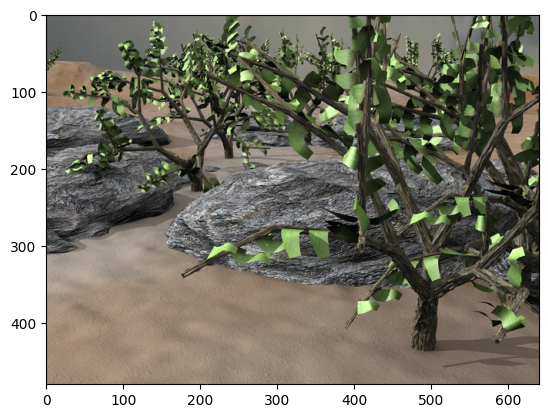

In [10]:

plt.imshow(image1_clr)

In [11]:
image1_gray = cv.cvtColor(image1_clr, cv.COLOR_RGB2GRAY)
image1_gray = np.float32(image1_gray)

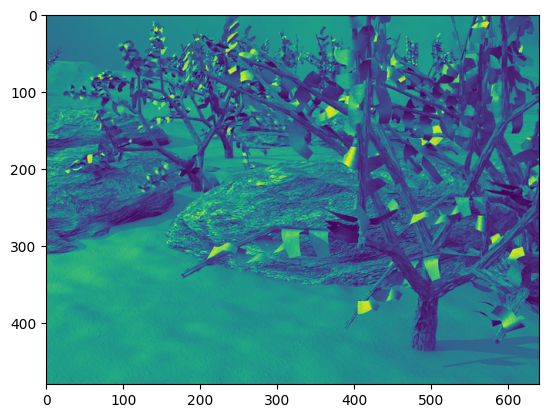

In [12]:
plt.imshow(image1_gray)

In [13]:
image1_dst = cv.cornerHarris(image1_gray, 2, 3, 0.04)

image1_dst = cv.dilate(image1_dst,None)

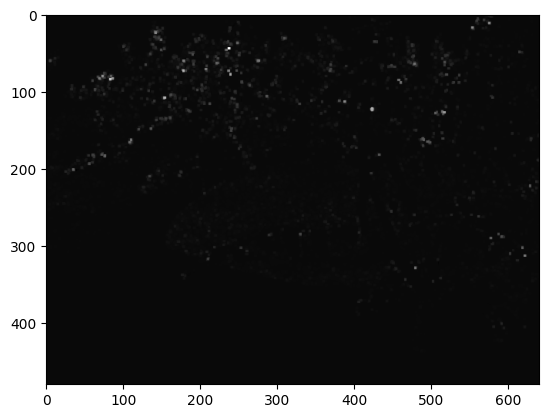

In [14]:
plt.imshow(image1_dst, cmap='gray')

In [15]:
thresh_img_1 = 0.1*image1_dst.max()

In [16]:
corner_image1 = np.copy(image1_clr)

In [17]:
corner_image1[image1_dst > thresh_img_1] = [255,0,0]

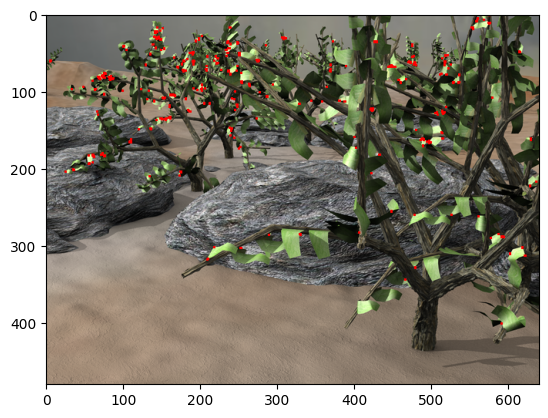

In [18]:
plt.imshow(corner_image1)

In [19]:
image2 = cv.imread('../data/all-frames-colour/RubberWhale/frame07.png')

In [20]:

image2_clr = cv.cvtColor(image2, cv.COLOR_BGR2RGB)

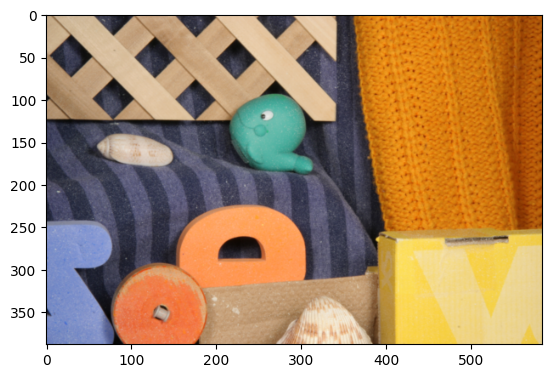

In [21]:

plt.imshow(image2_clr)

In [22]:
image2_gray = cv.cvtColor(image2_clr, cv.COLOR_RGB2GRAY)
image2_gray = np.float32(image2_gray)

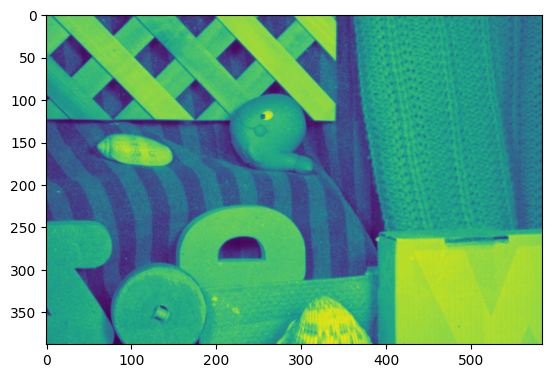

In [23]:
plt.imshow(image2_gray)

In [24]:
image2_dst = cv.cornerHarris(image2_gray, 2, 3, 0.04)

image2_dst = cv.dilate(image2_dst,None)

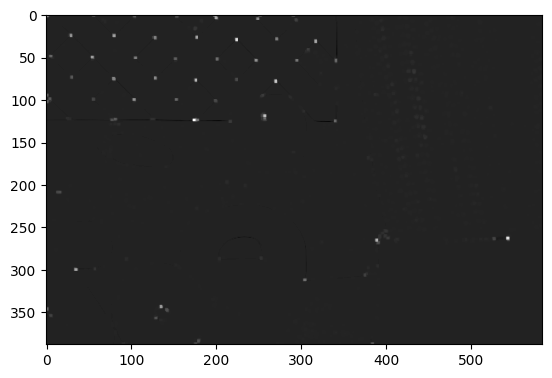

In [25]:
plt.imshow(image2_dst, cmap='gray')

In [26]:
thresh_img_2 = 0.1*image2_dst.max()

In [27]:
corner_image2 = np.copy(image2_clr)

In [28]:
corner_image2[image2_dst > thresh_img_2] = [255,0,0]


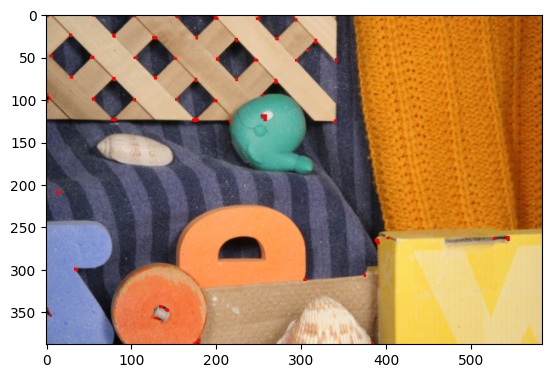

In [29]:
plt.imshow(corner_image2)

In [30]:
image3 = cv.imread('../data/all-frames-colour/Urban2/frame07.png')

In [31]:

image3_clr = cv.cvtColor(image3, cv.COLOR_BGR2RGB)

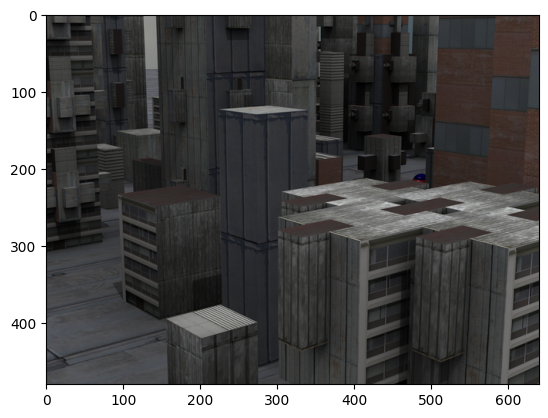

In [32]:

plt.imshow(image3_clr)

In [33]:
image3_gray = cv.cvtColor(image3_clr, cv.COLOR_RGB2GRAY)
image3_gray = np.float32(image3_gray)

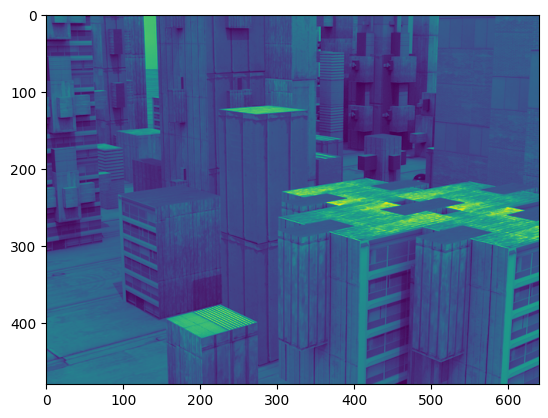

In [34]:
plt.imshow(image3_gray)

In [35]:
image3_dst = cv.cornerHarris(image3_gray, 2, 3, 0.04)

image3_dst = cv.dilate(image3_dst,None)

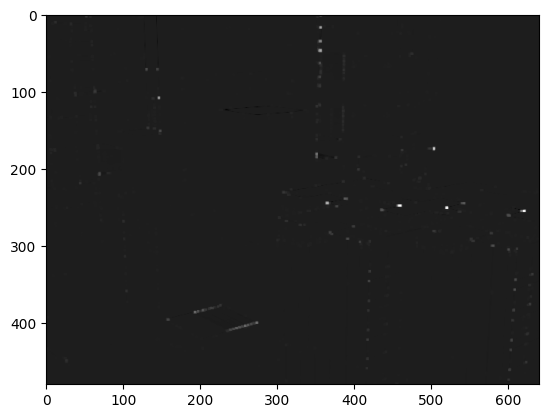

In [36]:
plt.imshow(image3_dst, cmap='gray')

In [37]:
thresh_img_3 = 0.1*image3_dst.max()

In [38]:
corner_image3 = np.copy(image3_clr)

In [39]:

corner_image3[image3_dst > thresh_img_3] = [255,0,0]

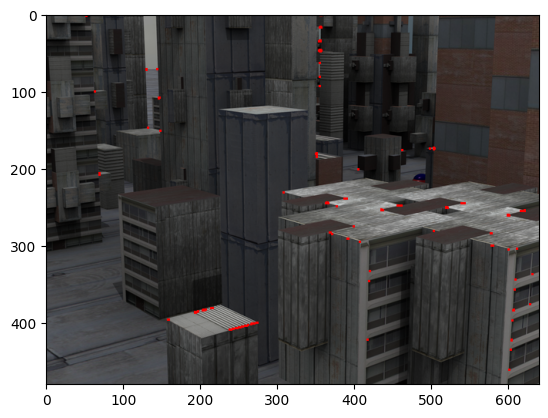

In [40]:
plt.imshow(corner_image3)

In [41]:
#LucasKanadeForwardAdditive(Img1, Img2, windowSize, tau)

In [3]:

UNKNOWN_FLOW_THRESH = 1e7
def show_flow(filename):
    """
    visualize optical flow map using matplotlib
    :param filename: optical flow file
    :return: None
    """
    flow = read_flow(filename)
    img = flow_to_image(flow)
    plt.imshow(img)
    plt.show(block=True)

def read_flow(filename):
    """
    read optical flow from Middlebury .flo file
    :param filename: name of the flow file
    :return: optical flow data in matrix
    """
    f = open(filename, 'rb')
    magic = np.fromfile(f, np.float32, count=1)
    data2d = None

    if 202021.25 != magic:
        print ('Magic number incorrect. Invalid .flo file')
    else:
        w = int(np.fromfile(f, np.int32, count=1)[0])
        h = int(np.fromfile(f, np.int32, count=1)[0])
        #print("Reading %d x %d flo file" % (h, w))
        data2d = np.fromfile(f, np.float32, count=2 * w * h)
        # reshape data into 3D array (columns, rows, channels)
        data2d = np.resize(data2d, (h, w, 2))
    f.close()
    return data2d

def flow_to_image(flow):
    """
    Convert flow into middlebury color code image
    :param flow: optical flow map
    :return: optical flow image in middlebury color
    """
    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999.
    maxv = -999.
    minu = 999.
    minv = 999.

    idxUnknow = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknow] = 0
    v[idxUnknow] = 0

    maxu = max(maxu, np.max(u))
    minu = min(minu, np.min(u))

    maxv = max(maxv, np.max(v))
    minv = min(minv, np.min(v))

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(-1, np.max(rad))

    u = u/(maxrad + np.finfo(float).eps)
    v = v/(maxrad + np.finfo(float).eps)

    img = compute_color(u, v)

    idx = np.repeat(idxUnknow[:, :, np.newaxis], 3, axis=2)
    img[idx] = 0

    return np.uint8(img)


def compute_color(u, v):
    """
    compute optical flow color map
    :param u: optical flow horizontal map
    :param v: optical flow vertical map
    :return: optical flow in color code
    """
    [h, w] = u.shape
    img = np.zeros([h, w, 3])
    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = make_color_wheel()
    ncols = np.size(colorwheel, 0)

    rad = np.sqrt(u**2+v**2)

    a = np.arctan2(-v, -u) / np.pi

    fk = (a+1) / 2 * (ncols - 1) + 1

    k0 = np.floor(fk).astype(int)

    k1 = k0 + 1
    k1[k1 == ncols+1] = 1
    f = fk - k0

    for i in range(0, np.size(colorwheel,1)):
        tmp = colorwheel[:, i]
        col0 = tmp[k0-1] / 255
        col1 = tmp[k1-1] / 255
        col = (1-f) * col0 + f * col1

        idx = rad <= 1
        col[idx] = 1-rad[idx]*(1-col[idx])
        notidx = np.logical_not(idx)

        col[notidx] *= 0.75
        img[:, :, i] = np.uint8(np.floor(255 * col*(1-nanIdx)))

    return img


def make_color_wheel():
    """
    Generate color wheel according Middlebury color code
    :return: Color wheel
    """
    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros([ncols, 3])

    col = 0

    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.transpose(np.floor(255*np.arange(0, RY) / RY))
    col += RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.transpose(np.floor(255*np.arange(0, YG) / YG))
    colorwheel[col:col+YG, 1] = 255
    col += YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.transpose(np.floor(255*np.arange(0, GC) / GC))
    col += GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.transpose(np.floor(255*np.arange(0, CB) / CB))
    colorwheel[col:col+CB, 2] = 255
    col += CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.transpose(np.floor(255*np.arange(0, BM) / BM))
    col += + BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.transpose(np.floor(255 * np.arange(0, MR) / MR))
    colorwheel[col:col+MR, 0] = 255

    return colorwheel

In [94]:
class LKOF:
    
    @staticmethod
    def euclidean_distance(v1, v2):
        return np.linalg.norm(v1-v2)
    
    @staticmethod
    def other_eror(v1, v2):
        return np.mean(np.sqrt(np.sum(np.square(v1-v2))))
    
    @staticmethod
    def imgradient(im):
        # kernel = np.array([[-1, 1],[-1, 1]])
        # return signal.convolve2d(im,kernel,boundary='symm',mode='same'),signal.convolve2d(im,kernel.T,boundary='symm',mode='same')
        # im = cv.normalize(im, None, 0, 255, cv.NORM_MINMAX).astype(np.uint8)
        return cv.Sobel(im, cv.CV_32F,1,0,ksize=3), cv.Sobel(im, cv.CV_32F,0,1,ksize=3)
                
    @staticmethod
    def lucaskanade_optflow(fame1, fame2, window_sz = 15, num_features = 100, t=1):
        frame1 = np.copy(fame1)
        frame2 = np.copy(fame2)
        frame1 = cv.cvtColor(frame1, cv.COLOR_BGR2GRAY)
        frame2 = cv.cvtColor(frame2, cv.COLOR_BGR2GRAY)
        feature_map = np.zeros(frame1.shape)
        frame1 = cv.normalize(frame1, None, 0, 255, cv.NORM_MINMAX).astype(np.float32)
        frame2 = cv.normalize(frame2, None, 0, 255, cv.NORM_MINMAX).astype(np.float32)
        sz = window_sz//2
        Ix,Iy = LKOF.imgradient(frame1)
        It = frame2 - frame1
        u = np.zeros(frame1.shape)
        v = np.zeros(frame1.shape)
        feature_map = np.zeros(frame1.shape)
        features = cv.goodFeaturesToTrack(frame1, num_features, 0.01, 10, useHarrisDetector=True).reshape(-1,2)
        
        for f in range(features.shape[0]):
            j,i = features[f,0], features[f,1]
            i = np.int32(i)
            j = np.int32(j)
            feature_map[i,j]=1

        for (x, y) in features:
            # Get the window around the current point in the gradient images
            x = int(x)
            y = int(y)
            Ix_win = Ix[y-sz:y+sz+1, x-sz:x+sz+1].flatten()
            Iy_win = Iy[y-sz:y+sz+1, x-sz:x+sz+1].flatten()
            It_win = It[y-sz:y+sz+1, x-sz:x+sz+1].flatten()

            A = np.vstack((Ix_win,Iy_win)).T
            b = np.dot(A.T,-It_win)
            A = np.dot(A.T,A)
            A_inv = np.linalg.pinv(A)
            (u[y,x],v[y,x]) = np.dot(A_inv,b)
                
        # fig, ax = plt.subplots()
        # ax.set_title("Vector Field")
        # ax.imshow(frame1, cmap = "gray")
        # for i in range(frame1.shape[0]):
        #     for j in range(frame1.shape[1]):
        #         if feature_map[i,j] == 1:
        #             if abs(u[i,j])>t or abs(v[i,j])>t:
        #                 plt.quiver(j,i,u[i,j],-v[i,j],color = "r")
        # plt.axis('off')
        # plt.show()
        return u,v,feature_map
    
    @staticmethod
    def OpenCVLK(frame1, frame2, t=0.05):
        frame_1 = np.copy(frame1)
        frame_2 = np.copy(frame2)
        feature_params = dict(maxCorners=200, qualityLevel=0.01, minDistance=10, blockSize=7)
    
        # Parameters for Lucas Kanade optical flow
        lk_params = dict(
            winSize=(15, 15),
            maxLevel=2,
            criteria=(cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03),
        )
    
        # Create random colors
        color = np.random.randint(0, 255, (100, 3))
    
        # Take first frame and find corners in it
        old_gray = cv.cvtColor(frame_1, cv.COLOR_BGR2GRAY)
        p0 = cv.goodFeaturesToTrack(old_gray, mask=None, useHarrisDetector=True, **feature_params)
        feature_map = np.zeros(old_gray.shape)
        # p0 = cv.goodFeaturesToTrack(frame1, 1000 , 0.01, 20, useHarrisDetector=True, **feature_params).reshape(-1,2)
        feature_track = np.reshape(p0, (-1,2))
        for f in range(feature_track.shape[0]):
            j,i = feature_track[f,0] , feature_track[f,1]
            i = np.int32(i)
            j = np.int32(j)
            feature_map[i,j]=1
        # Create a mask image for drawing purposes
        mask = np.zeros_like(frame_1)
        frame_gray = cv.cvtColor(frame_2, cv.COLOR_BGR2GRAY)
    
        # Calculate Optical Flow
        p1, st, err = cv.calcOpticalFlowPyrLK(
            old_gray, frame_gray, p0, None
        )
        # Select good points
        # good_new = p1[st != 100]
        good_new = p1[st == 1]
        # good_old = p0[st != 100]
        good_old = p0[st == 1]
    
        flow_vectors = good_new - good_old
        # plt.imshow(frame1)
        # plt.quiver(good_old[:, 0], good_old[:, 1], flow_vectors[:, 0], -flow_vectors[:, 1], color='r')
        # plt.show()

        return good_old, flow_vectors
    
    @staticmethod
    def lucaskanade(frame1, frame2, window_sz, u0, v0, t=0.01):
        sz = window_sz // 2
        
        frame1 = cv.normalize(frame1, None, 0, 255, cv.NORM_MINMAX).astype(np.float32)
        frame2 = cv.normalize(frame2, None, 0, 255, cv.NORM_MINMAX).astype(np.float32)
        Ix, Iy = LKOF.imgradient(frame1)

        u, v = np.zeros(frame1.shape), np.zeros(frame1.shape)
        for y in range(sz, frame1.shape[0]-sz):
            for x in range(sz, frame1.shape[1]-sz):
                
                Ix_win = Ix[y-sz:y+sz+1, x-sz:x+sz+1].flatten()
                Iy_win = Iy[y-sz:y+sz+1, x-sz:x+sz+1].flatten()
                if y+int(u0[y,x])-sz < 0 or y+int(u0[y,x])+sz+1 >= frame1.shape[0] or x+int(v0[y,x])-sz < 0 or x+int(v0[y,x])+sz+1 >= frame1.shape[1]:
                    continue
                It_win = (frame2[y+int(u0[y,x])-sz:y+int(u0[y,x])+sz+1, x+int(v0[y,x])-sz:x+int(v0[y,x])+sz+1] - frame1[y-sz:y+sz+1, x-sz:x+sz+1]).flatten()

                A = np.vstack((Ix_win, Iy_win)).T
                b = -It_win
                delta = np.linalg.pinv(A).dot(b)
                if abs(delta[0]) > t:
                    u[y, x] = delta[0] + u0[y, x]
                if abs(delta[1]) > t:
                    v[y, x] = delta[1] + v0[y, x]
        return u, v

    @staticmethod
    def OpticalFlowRefine(Img1, Img2, window_sz, u0, v0, t):
        return LKOF.lucaskanade(Img1, Img2, window_sz, u0, v0, t)
    
    @staticmethod
    def MultiScaleLucasKanade(Img1_, Img2_, window_sz=15, num_levels=5, num_features=50, t=0.01):
        Img1, Img2 = np.copy(Img1_), np.copy(Img2_)
        Img1 = cv.cvtColor(Img1, cv.COLOR_BGR2GRAY)
        Img2 = cv.cvtColor(Img2, cv.COLOR_BGR2GRAY)
        Img1, Img2 = cv.GaussianBlur(Img1, (5, 5), 0), cv.GaussianBlur(Img2, (5, 5), 0)
        u, v = np.zeros(Img1.shape), np.zeros(Img1.shape)
        feature_points = cv.goodFeaturesToTrack(Img1, num_features, 0.01, 10, useHarrisDetector=True).reshape(-1,2)
        feature_map = np.zeros_like(Img1)
        for level in range(num_levels, 0, -1):
            scale = 2**(1-level)
            Img1_scaled = cv.resize(Img1, (0,0), fx=scale, fy=scale, interpolation=cv.INTER_AREA)
            Img2_scaled = cv.resize(Img2, (0,0), fx=scale, fy=scale, interpolation=cv.INTER_AREA)
            # feature_points_scaled = feature_points / scale
            u_scaled, v_scaled = LKOF.OpticalFlowRefine(Img1_scaled, Img2_scaled, window_sz, u/scale, v/scale, t)
            u = cv.resize(u_scaled, (Img1.shape[1], Img1.shape[0]))
            v = cv.resize(v_scaled, (Img1.shape[1], Img1.shape[0]))

            if level > 1:
                u = cv.resize(u, (0,0), fx=2, fy=2, interpolation=cv.INTER_LINEAR)
                v = cv.resize(v, (0,0), fx=2, fy=2, interpolation=cv.INTER_LINEAR)

        for f in range(feature_points.shape[0]):
            j, i = feature_points[f]
            i, j = int(i), int(j)
            if np.sqrt(u[i, j]**2 + v[i, j]**2) > 0:
                # feature_map = cv.circle(feature_map, (j, i), 3, (0, 255, 0), -1)
                feature_map[i,j] = 1
        return u, v, feature_map


In [110]:
class Util:
    def __init__(self, lib):
        self.lib = lib
        self.value = None
        self.frame = None
        self.value2 = None

    def displaying_flow(self, flag, buff):

        def helper(obj, frame1,  u, v, feature_map, t=0.04):
            for i in range(frame1.shape[0]):
                for j in range(frame1.shape[1]):
                    if feature_map[i,j] == 1:
                        if abs(u[i,j])>t or abs(v[i,j])>t:
                            obj.quiver(j,i,u[i,j],-v[i,j],color = "r")

        ncols = (3 if flag else 2)
        nrows = len(buff)
        fig, axi = plt.subplots(nrows=nrows, ncols=ncols, constrained_layout=False, figsize=(15,45))
        for i, (img, pkt1, pkt2, pkt3) in enumerate(buff):
            # axi[i].set_xlabel("image " + str(i+1), fontsize=14)
            # axi[i].axis('off')

            img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
            axi[i,0].imshow(img)

            helper(axi[i, 0], img, *pkt1)
            
            axi[i, 0].axis('off')
            axi[i, 0].set_title('Single Scale Implementation')
            w = 1
            if(flag):
                axi[i, w].imshow(img)
                helper(axi[i, w], img, *pkt2, t=0.0004)
                axi[i, w].axis('off')
                axi[i, w].set_title('Multi-Scale Implementation')
                w += 1
            
            axi[i, w].imshow(img)
            # helper(axi[i, w], img, *pkt3)
            good_old, flow_vectors = pkt3
            axi[i,w].quiver(good_old[:, 0], good_old[:, 1], flow_vectors[:, 0], -flow_vectors[:, 1], color='r')
            axi[i, w].axis('off')
            axi[i, w].set_title('OpenCV Implementation')

        plt.show()

    def run_lkof(self, flag=False):
        files = os.listdir(self.lib)
        buffer = []
        for i in range(len(files)-1):
            img_1 = cv.imread(self.lib + files[i])
            img_2 = cv.imread(self.lib + files[i+1])
            pkt = LKOF.lucaskanade_optflow(img_1, img_2,window_sz=5, num_features=60,t=0.03)
            if(i == 3):
                self.frame = cv.cvtColor(img_1, cv.COLOR_BGR2RGB)
                self.value = pkt
            pkt2 = None
            if(flag):
                pkt2 = LKOF.MultiScaleLucasKanade(img_1, img_2, window_sz=6, num_features=60, t=0.0004)
                self.value2 = pkt2
            pkt3 = LKOF.OpenCVLK(img_1, img_2)
            buffer.append([img_1, pkt, pkt2, pkt3])

        self.displaying_flow(flag, buffer)

    def print_error(self, grnd_truth_lib, other=False):
        ggrnd_truth = read_flow(grnd_truth_lib)
        self.grnd_truth = ggrnd_truth
        ggrnd_u = ggrnd_truth[:,:,0]
        ggrnd_v = ggrnd_truth[:,:,1]
        gu, gv, gfeature_map = (self.value2 if other else self.value)
        epe = LKOF.euclidean_distance(np.array((ggrnd_u[gfeature_map==1], ggrnd_v[gfeature_map==1])), np.array((gu[gfeature_map==1], gv[gfeature_map==1])))
        print('The epe is', epe)



    def show_with_flow(self, t=0.05):
        def display_flow(frame1, feature_map, u, v, t=0.05):
            plt.imshow(frame1, cmap = "gray")
            for i in range(frame1.shape[0]):
                for j in range(frame1.shape[1]):
                    if feature_map[i,j] == 1:
                        if abs(u[i,j])>t or abs(v[i,j])>t:
                            plt.quiver(j,i,u[i,j],-v[i,j],color = "r")
            plt.axis('off')
            plt.show()
        u = self.grnd_truth[:,:,0]
        v = self.grnd_truth[:, :, 1]
        gu, gv, feature_map = self.value
        display_flow(self.frame, feature_map, u, v, t)


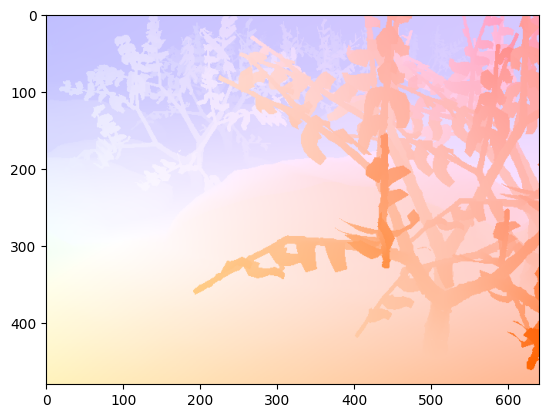

In [74]:
show_flow('../data/ground-truth-flow/Grove3/flow10.flo')

In [88]:
grove_obj = Util('../data/all-frames-colour/Grove3/')

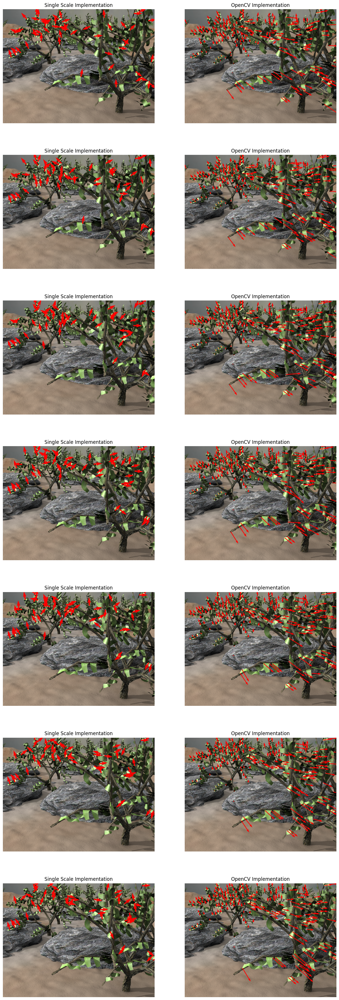

In [89]:
grove_obj.run_lkof()

In [90]:
grove_obj.print_error('../data/ground-truth-flow/Grove3/flow10.flo')

The epe is 31.75529970181878


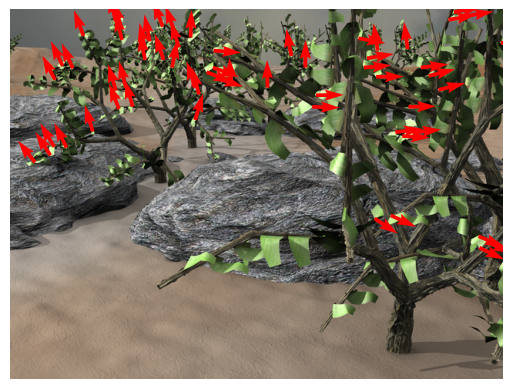

In [78]:
grove_obj.show_with_flow()

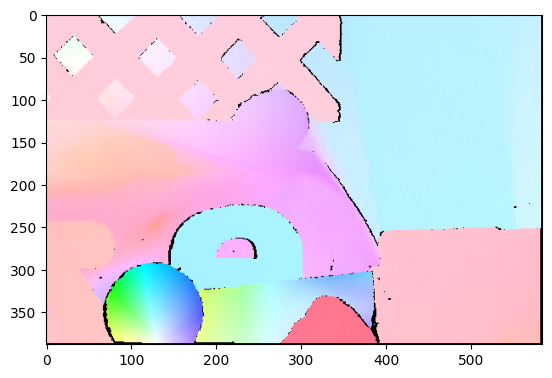

In [ ]:
show_flow('../data/ground-truth-flow/RubberWhale/flow10.flo')

In [79]:
rubber_whale_obj = Util('../data/all-frames-colour/RubberWhale/')

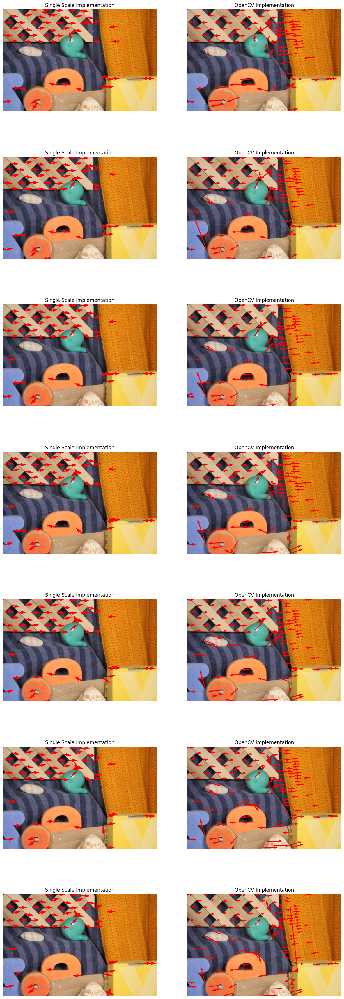

In [80]:
rubber_whale_obj.run_lkof()

In [81]:
rubber_whale_obj.print_error('../data/ground-truth-flow/RubberWhale/flow10.flo')

The epe is 4714045449.124223


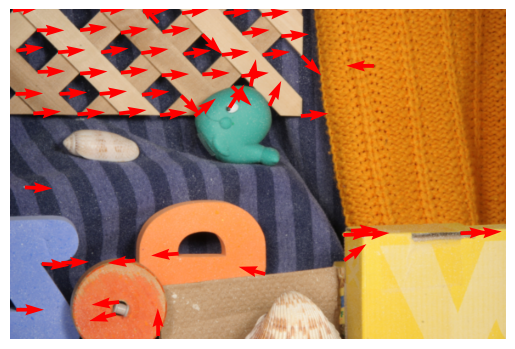

In [82]:
rubber_whale_obj.show_with_flow()

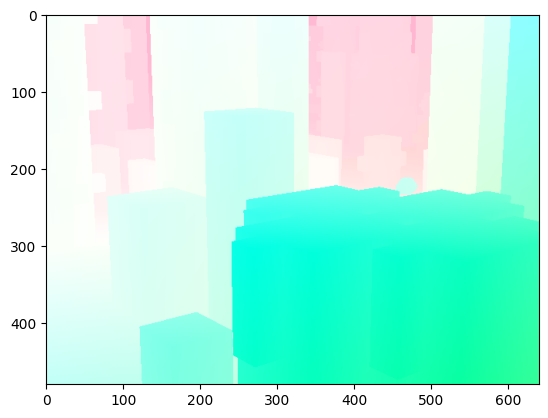

In [ ]:
show_flow('../data/ground-truth-flow/Urban2/flow10.flo')

In [83]:
urban_obj = Util('../data/all-frames-colour/Urban2/')

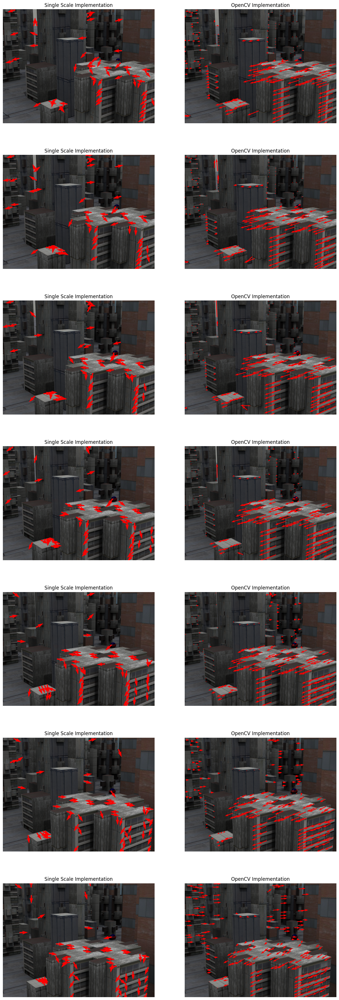

In [84]:
urban_obj.run_lkof()

In [85]:
urban_obj.print_error('../data/ground-truth-flow/Urban2/flow10.flo')

The epe is 123.42566693306662


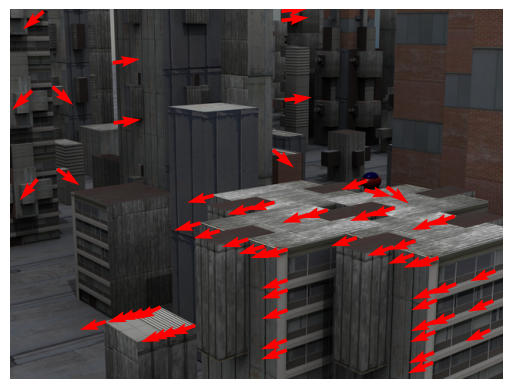

In [86]:
urban_obj.show_with_flow()

In [98]:
grove_obj2 = Util('../data/all-frames-colour/Grove3/')

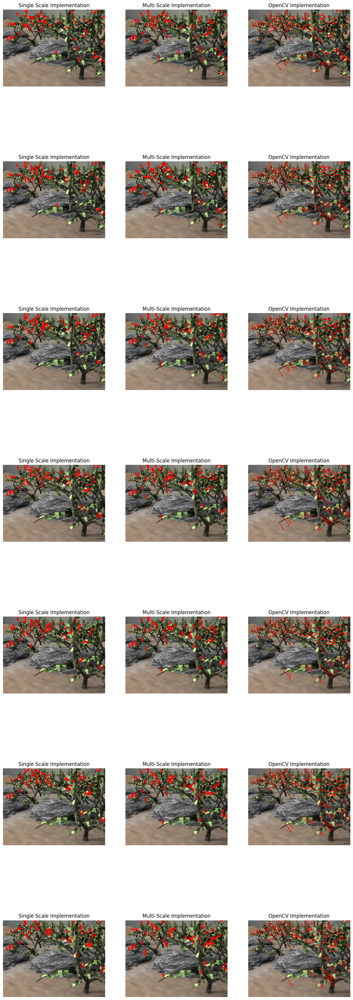

In [99]:
grove_obj2.run_lkof(flag=True)

In [100]:
grove_obj2.print_error('../data/ground-truth-flow/Grove3/flow10.flo', other=True)

The epe is 30.61373052622513


In [104]:
rubber_whale_obj2 = Util('../data/all-frames-colour/RubberWhale/')

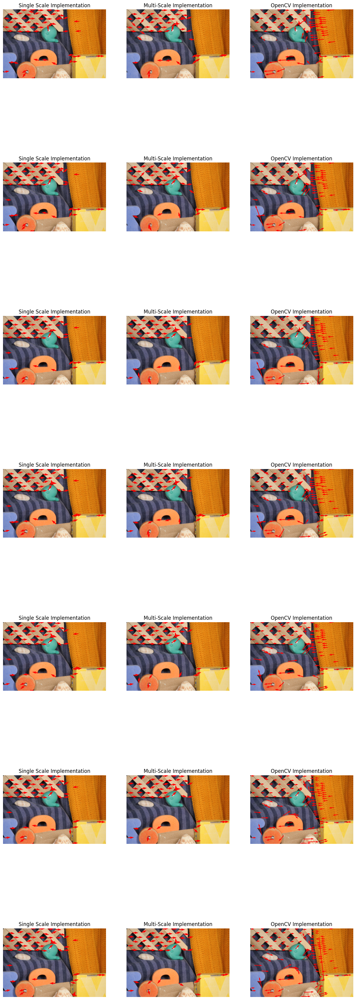

In [105]:
rubber_whale_obj2.run_lkof(flag=True)

In [106]:
rubber_whale_obj2.print_error('../data/ground-truth-flow/RubberWhale/flow10.flo', other=True)

The epe is 4082483113.424748


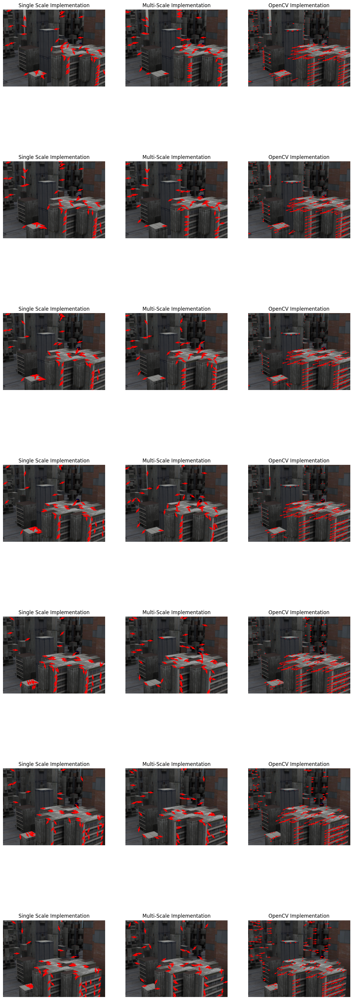

The epe is 117.12270378225045


In [109]:
urban_obj2 = Util('../data/all-frames-colour/Urban2/')
urban_obj2.run_lkof(flag=True)
urban_obj2.print_error('../data/ground-truth-flow/Urban2/flow10.flo', other=True)